# Picking out some outliers

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from scipy.stats import ttest_ind

# for converting cielab to LCh
from colormath.color_objects import LabColor, LCHabColor
from colormath.color_conversions import convert_color

import os
import json
import base64
import cv2
from PIL import Image
from io import BytesIO

# Read in full dataset

In [2]:
color_df = pd.read_csv('../datasets/1-clusters/cluster1.csv')

In [3]:
color_df_reduced = (
    color_df.groupby("gbifID", sort=False, group_keys=False)
    .apply(lambda x: x.sample(1))
    .reset_index(drop=True)
)
color_df_reduced

/var/folders/qh/c7rwx84921n2kznn09zb2pnh0000gn/T/ipykernel_86269/411184798.py:3: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.sample(1))


,image_idx,hex,rgb,hsl,lab,gbifID,identifier,latitude,longitude
0,0,#d4b4de,"(212, 180, 222)","(0.7936507936507936, 0.38888888888888895, 0.78...","(197, 147, 111)",923911394,https://inaturalist-open-data.s3.amazonaws.com...,48.826305,-102.092171
1,2,#cdb2cb,"(205, 178, 203)","(0.8456790123456791, 0.21259842519685052, 0.75...","(193, 142, 119)",923910407,https://inaturalist-open-data.s3.amazonaws.com...,43.613086,-73.057076
2,4,#bba6d7,"(187, 166, 215)","(0.738095238095238, 0.3798449612403101, 0.7470...","(182, 145, 106)",899970365,https://inaturalist-open-data.s3.amazonaws.com...,43.066871,-87.890565
3,7,#9984ae,"(153, 132, 174)","(0.75, 0.2058823529411765, 0.6000000000000001)","(149, 144, 109)",891778924,https://inaturalist-open-data.s3.amazonaws.com...,42.140556,-87.831643
4,9,#ba9edb,"(186, 158, 219)","(0.7431693989071038, 0.4586466165413533, 0.739...","(177, 150, 101)",891760719,https://inaturalist-open-data.s3.amazonaws.com...,38.679240,-97.990035
...,...,...,...,...,...,...,...,...,...
16582,41059,#9f8fc0,"(159, 143, 192)","(0.7210884353741497, 0.27999999999999997, 0.65...","(159, 144, 105)",1024218211,https://inaturalist-open-data.s3.amazonaws.com...,41.569419,-88.150552
16583,41060,#b47eb0,"(180, 126, 176)","(0.845679012345679, 0.2647058823529413, 0.6000...","(152, 157, 110)",1024202810,https://inaturalist-open-data.s3.amazonaws.com...,45.057871,-87.168277
16584,41061,#ae95c8,"(174, 149, 200)","(0.7483660130718954, 0.31677018633540366, 0.68...","(167, 147, 105)",1024200169,https://inaturalist-open-data.s3.amazonaws.com...,42.921738,-88.026752
16585,41063,#c8b9b1,"(200, 185, 177)","(0.057971014492753624, 0.17293233082706772, 0....","(194, 132, 134)",1024198670,https://inaturalist-open-data.s3.amazonaws.com...,40.791723,-80.492498


# Get cielab values and convert to lch

In [4]:
L = [(int(i.strip('()').split(', ')[0])) for i in color_df_reduced.lab]
L = (np.array(L) / 255.0) * 100.0  
color_df_reduced['L'] = L
a = [(int(i.strip('()').split(', ')[1])) for i in color_df_reduced.lab]
a = np.array(a) - 128.0  
color_df_reduced['a'] = a
b = [(int(i.strip('()').split(', ')[2])) for i in color_df_reduced.lab]
b = np.array(b) - 128.0
color_df_reduced['b'] = b

In [5]:
lab_vals = np.array(color_df_reduced[['L','a','b']])

lch_arr = np.empty_like(lab_vals)
for i, (L_, a_, b_) in enumerate(lab_vals):
    # had to think carefully here -- these look like the correct defaults
    # rather than d50 illuminant because of I used opencv at its default
    lab = LabColor(L_, a_, b_, observer='2', illuminant='d65') 
    lch = convert_color(lab, LCHabColor)
    lch_arr[i] = lch.get_value_tuple()

In [6]:
color_df_reduced['lch_l'] = lch_arr[:,0]
color_df_reduced['lch_c'] = lch_arr[:,1]
color_df_reduced['lch_h'] = lch_arr[:,2]

# Make outlier dataframe of the images with low hue values

In [7]:
outlier_df = color_df_reduced[color_df_reduced.lch_h < 250]

In [8]:
outlier_df

,image_idx,hex,rgb,hsl,lab,gbifID,identifier,latitude,longitude,L,a,b,lch_l,lch_c,lch_h
13,24,#f2e2de,"(242, 226, 222)","(0.033333333333333236, 0.4347826086956518, 0.9...","(232, 133, 132)",891174786,https://inaturalist-open-data.s3.amazonaws.com...,41.064969,-80.088517,90.980392,5.0,4.0,90.980392,6.403124,38.659808
15,31,#ddcece,"(221, 206, 206)","(0.0, 0.18072289156626511, 0.8372549019607843)","(214, 133, 130)",891165845,https://inaturalist-open-data.s3.amazonaws.com...,35.987120,-79.057745,83.921569,5.0,2.0,83.921569,5.385165,21.801409
58,215,#efcdd4,"(239, 205, 212)","(0.9656862745098039, 0.5151515151515151, 0.870...","(218, 141, 129)",5062802364,https://inaturalist-open-data.s3.amazonaws.com...,43.111588,-88.414557,85.490196,13.0,1.0,85.490196,13.038405,4.398705
116,368,#c8c3c0,"(200, 195, 192)","(0.06249999999999978, 0.06779661016949151, 0.7...","(202, 129, 130)",5062742129,https://inaturalist-open-data.s3.amazonaws.com...,42.156086,-88.013619,79.215686,1.0,2.0,79.215686,2.236068,63.434949
230,739,#dbdad8,"(219, 218, 216)","(0.11111111111111112, 0.03999999999999985, 0.8...","(222, 128, 129)",5007989883,https://inaturalist-open-data.s3.amazonaws.com...,34.641586,-92.941214,87.058824,0.0,1.0,87.058824,1.000000,90.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16470,40800,#d4bec0,"(212, 190, 192)","(0.9848484848484849, 0.20370370370370386, 0.78...","(201, 136, 130)",1291127234,https://inaturalist-open-data.s3.amazonaws.com...,38.987262,-76.455593,78.823529,8.0,2.0,78.823529,8.246211,14.036243
16498,40866,#c3d4d8,"(195, 212, 216)","(0.5317460317460316, 0.21212121212121224, 0.80...","(214, 123, 124)",1291090132,https://inaturalist-open-data.s3.amazonaws.com...,30.490785,-95.268910,83.921569,-5.0,-4.0,83.921569,6.403124,218.659808
16550,41004,#cdd6d8,"(205, 214, 216)","(0.5303030303030303, 0.12359550561797737, 0.82...","(217, 125, 126)",1132416630,https://inaturalist-open-data.s3.amazonaws.com...,39.430161,-77.772789,85.098039,-3.0,-2.0,85.098039,3.605551,213.690068
16564,41026,#cfc7bd,"(207, 199, 189)","(0.09259259259259256, 0.1578947368421052, 0.77...","(206, 129, 134)",1099970054,https://inaturalist-open-data.s3.amazonaws.com...,35.176589,-93.617656,80.784314,1.0,6.0,80.784314,6.082763,80.537678


In [9]:
outlier_idxs = list(outlier_df.image_idx)

# Now look at the first 30 outliers with their segmentation masks and selected colors:

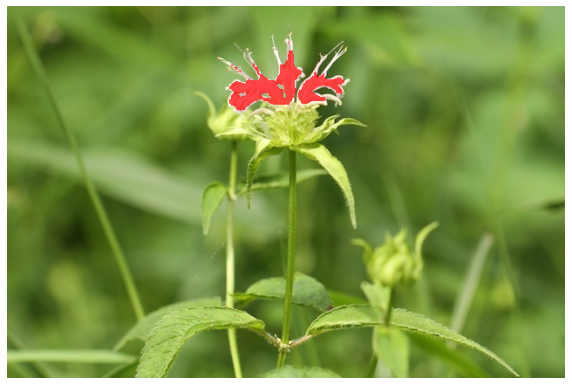

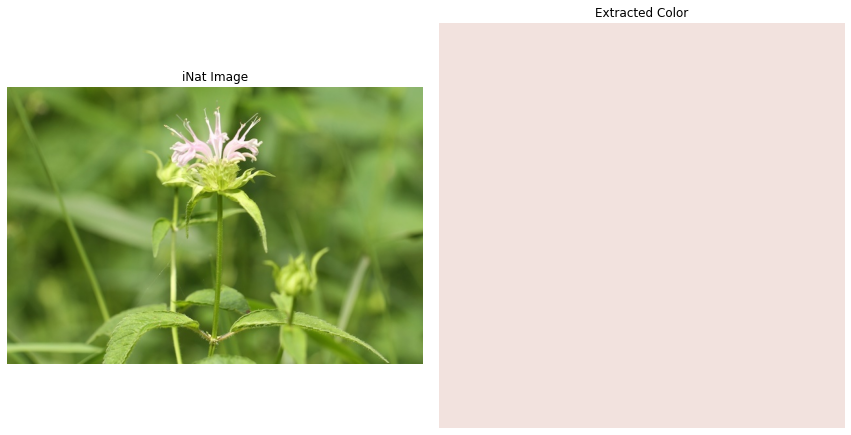

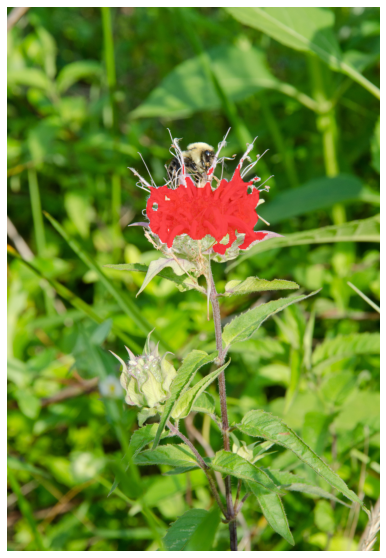

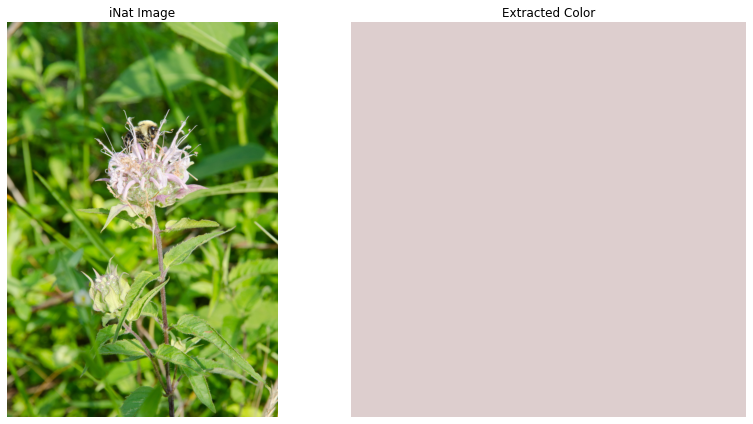

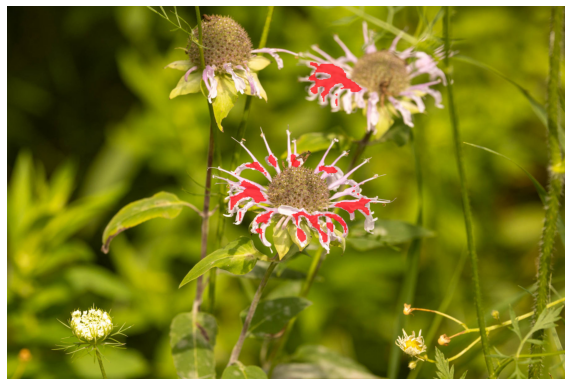

...

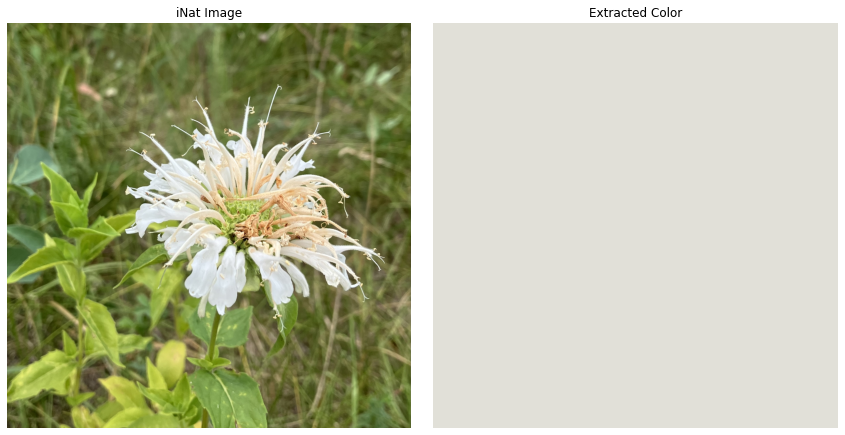

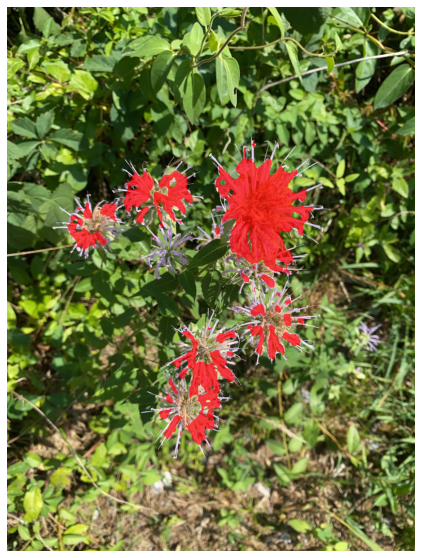

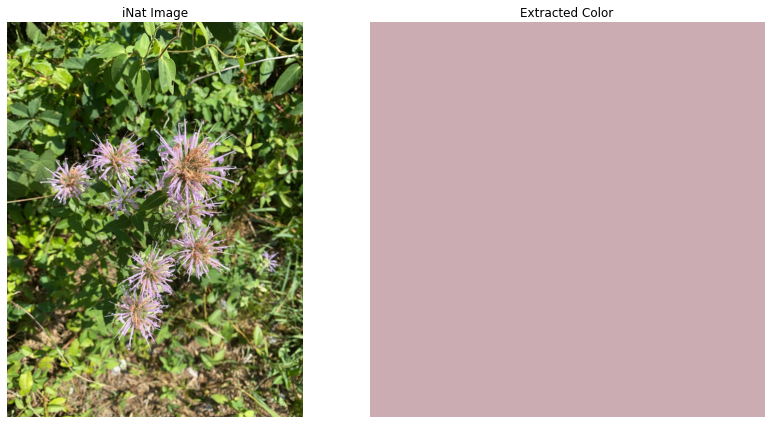

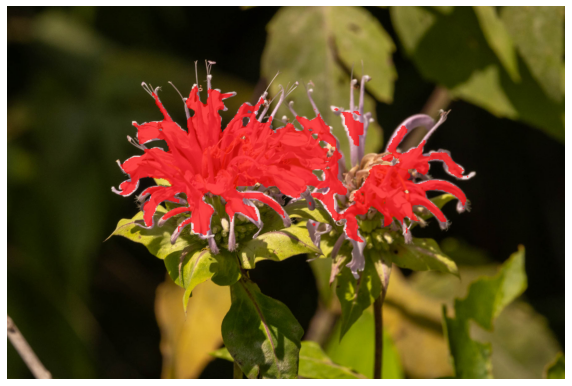

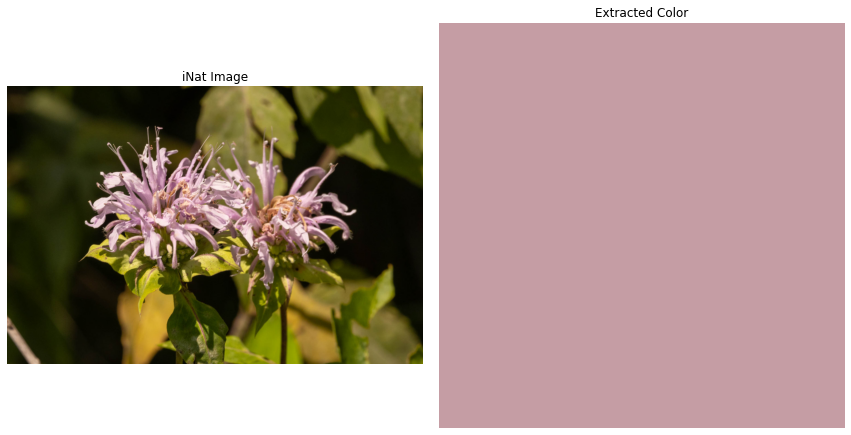

In [10]:
image_idxs = outlier_idxs[:30]
images = [str(i)+'.jpg' for i in image_idxs]
subdf = color_df[color_df.image_idx.isin(image_idxs)]

for image in images:
    ##############
    # FIRST show segmentation mask from figure 1 notebook
    ##############
    image_path = os.path.join("/Volumes/My Passport/monarda_fistulosa_segmentation/image_dataset/gpt_filtered_images/",image)
    base_name = os.path.basename(image_path)
    base_name_no_ext = os.path.splitext(base_name)[0]
    json_path = os.path.join('/Volumes/My Passport/monarda_fistulosa_segmentation/segmentation_results',f"{base_name_no_ext}.json")

    with open(json_path, "r") as json_file:
        data = json.load(json_file)

    # base64 segmentation mask
    seg_mask_base64 = data['segmentation_mask']

    # decode mask
    mask_data = base64.b64decode(seg_mask_base64)
    mask_image = Image.open(BytesIO(mask_data))
    mask_np = np.array(mask_image)

    # read the image
    orig_img = cv2.imread(image_path)
    orig_img_rgb = cv2.cvtColor(orig_img, cv2.COLOR_BGR2RGB)

    # resize mask to match image dims
    mask_resized = cv2.resize(mask_np, (orig_img_rgb.shape[1], orig_img_rgb.shape[0]), interpolation=cv2.INTER_NEAREST)
    

    alpha = 0.7 # transparency
    mask_bool = mask_resized.astype(bool)

    # make a copy to draw on
    overlay = orig_img_rgb.copy()

    # solid mask color
    color = np.array([255, 0, 0], dtype=np.float32)

    # adding transparency
    # for each channel, blend only where mask==1
    for c in range(3):
        # orig channel values
        orig_chan = overlay[..., c].astype(np.float32)
        # blended channel
        # = (1-alpha)*orig + alpha*color[c]
        blended = (1 - alpha) * orig_chan + alpha * color[c]
        # write back only under mask
        orig_chan[mask_bool] = blended[mask_bool]
        overlay[..., c] = orig_chan.astype(np.uint8)

    # now plot/save
    plt.figure(figsize=(10,10))
    plt.imshow(overlay)
    plt.axis('off')
    plt.savefig(f"../figures/figure_puzzling/outliers/mask_{image}", dpi=300, bbox_inches='tight')
    plt.show()
    
    
    ################
    # Next show extracted color
    ################
    image_path = os.path.join("/Volumes/My Passport/monarda_fistulosa_segmentation/image_dataset/gpt_filtered_images/",image)
    base_name = os.path.basename(image_path)
    image_idx = int(image.split('.')[0])

    # read in iamge
    orig_img = cv2.imread(image_path)
    orig_img_rgb = cv2.cvtColor(orig_img, cv2.COLOR_BGR2RGB)
    
    # get the rgb from the table
    rgb_str = subdf[subdf.image_idx.eq(image_idx)].rgb.iloc[0]
    # convert to ints
    rgb = rgb_str.strip('()').split(', ')
    rgb = [int(i) for i in rgb]
    
    # make a color patch with the extracted color
    patch_height, patch_width = 5, 5  # block size
    color_patch = np.zeros((patch_height, patch_width, 3), dtype=np.uint8)
    color_patch[:] = rgb

    # side-by-side plot
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # original image
    axes[0].imshow(orig_img_rgb)
    axes[0].set_title("iNat Image")
    axes[0].axis('off')

    # color patch
    axes[1].imshow(color_patch)
    axes[1].set_title("Extracted Color")
    axes[1].axis('off')

    # plot and write
    plt.tight_layout()
    plt.savefig(f"../figures/figure_puzzling/outliers/swatch_{image}", dpi=300, bbox_inches="tight")
    plt.show()